<a href="https://colab.research.google.com/github/Zeaxanthin80/CAI2840C/blob/main/Assignments/Assignment_5_copy.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Assignment 5 (Week 4)

## Assignment: Video Processing and Contour Detection Using OpenCV

reference:  https://colab.research.google.com/drive/1_FGt6GyViY1BAK2dIpf5DFjpH79zBV5E?usp=sharingLinks

**Objective:**

In this assignment, you will gain hands-on experience with OpenCV by building three applications in a Google Colab notebook:

1. **Video I/O Application:** Read from and write to a video stream. You can modify or extend the code we used in class.
2. **Motion Detection Application:** Develop a motion detection system that explains the concepts of foreground mass (the difference between the background model and the current frame) and erosion (a morphological operation used to remove noise). You should demonstrate erosion on a new video clip.
3. **Contour Detection Application:** Write code that identifies and draws contours on an image. For extra credit, extend your solution to detect and draw contours in a video (with a clip that is less than one minute long).



---



## Part 1: Video I/O Application

**Requirements:**

- **Input:** Use any video file of your choice (or create one, e.g., using your webcam or a synthetic video clip that is less than 1 minute long).
- **Processing:** Implement a simple transformation on each frame (this can be as basic as converting to grayscale, overlaying text, or drawing shapes).
- **Output:** Write the processed frames to a new video file.

**Instructions:**

1. **Reading the Video:**
    - Use cv2.VideoCapture to open the video file.
    - Loop through each frame and perform your processing.
2. **Processing the Frames:**
    - Apply your chosen transformation (for example, add a timestamp overlay or convert to grayscale).
3. **Writing the Video:**
    - Use cv2.VideoWriter to create an output video file.
    - Write the processed frames to this file.

Hint: Ensure your output video settings (frame size, codec, and frame rate) match the input video.

In [4]:
# Cell 1: Opening the Video
    # Opens the video file using cv2.VideoCapture.
    # Checks if the video opened successfully.
    # Gets video properties (width, height, FPS).

import cv2

# Path to your video file
video_path = '/content/Visuals/bears2.mp4'

# Create a VideoCapture object
cap = cv2.VideoCapture(video_path)

# Check if the video file was successfully opened
if not cap.isOpened():
    print("Error opening video file")
else:
    print("Video file loaded successfully.")

# Get video properties (frame width, height, FPS)
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = cap.get(cv2.CAP_PROP_FPS)

print("Frame width:", frame_width)
print("Frame height:", frame_height)
print("FPS:", fps)

Video file loaded successfully.
Frame width: 1280
Frame height: 720
FPS: 25.0


In [5]:
# Cell 1.5: Playback Original Video (using IPython)

from IPython.display import Video

# Display the original video
Video(video_path, embed=True, width=640, height=480)

In [6]:
# Cell 2: Processing the Video
# Creates a cv2.VideoWriter object to write the output video.
# Enters a loop to read frames from the input video.
# Converts each frame to grayscale using cv2.cvtColor.
# Annotates the frame with the FPS using cv2.putText.
# Writes the processed frame to the output video using out.write.

import time
import os

# Define the codec and create VideoWriter object
# Define the codec and create VideoWriter object
# Changed codec to 'MJPG' for better compatibility
fourcc = cv2.VideoWriter_fourcc(*'H264')
frame_rate = int(cap.get(cv2.CAP_PROP_FPS))
frame_rate = int(frame_rate/3)

# Specify the output file path
output_video_path = '/content/Visuals/output_video.mp4'

# Check if the output directory exists, create it if not
output_dir = os.path.dirname(output_video_path)
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

# Remove the bufferSize argument as it is causing the error.
out = cv2.VideoWriter(output_video_path, fourcc, frame_rate, (frame_width, frame_height), isColor=False)

# Check if the VideoWriter object was created successfully
if not out.isOpened():
    print("Error creating VideoWriter object. Check codec and file path.")
    exit()  # Exit the script if VideoWriter creation fails

# Variables to calculate and display FPS
prev_frame_time = 0
new_frame_time = 0

# Total number of frames in the video
total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
# Frame counter
frame_count = 0

while(cap.isOpened()):
    ret, frame = cap.read()

    if not ret:
        print("Frame read error or end of video reached.")
        break  # Break the loop if no frame is read

    # Convert the frame to grayscale (black & white)
    gray_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    # Calculate and display FPS
    new_frame_time = time.time()
    fps = 1/(new_frame_time-prev_frame_time) # This fps is for display, not for VideoWriter
    prev_frame_time = new_frame_time
    fps = int(fps)
    fps = str(fps)
    cv2.putText(gray_frame, fps, (7, 70), cv2.FONT_HERSHEY_SIMPLEX, 3, (100, 255, 0), 3, cv2.LINE_AA)

    # Write the processed frame to the output video
    out.write(gray_frame)

    # Update frame counter and print progress
    frame_count += 1
    print(f"Processed frame {frame_count}/{total_frames}", end="\r")

# Flush and release resources
# out.flush()  # Flush the VideoWriter buffer #Removed line as VideoWriter has no flush() method
cap.release()
out.release()
cv2.destroyAllWindows()

print("Video processing and writing completed.")
print("\nVideo processing completed.") # Print completion message on a new line

Error creating VideoWriter object. Check codec and file path.
Frame read error or end of video reached.
Video processing and writing completed.

Video processing completed.


In [1]:
# Cell 2.5: Playback Processed Video (using IPython)

from IPython.display import Video

# Display the processed video
# Assuming the output video file is named 'output_video.avi'
path_pro = '/content/Visuals/output_video.mp4'
Video(path_pro)

ValueError: To embed videos, you must pass embed=True (this may make your notebook files huge)
Consider passing Video(url='...')

In [10]:
import moviepy.editor
moviepy.editor.ipython_display('/content/Visuals/output_video.mp4')

In [8]:
# Cell 2: Processing the Video
# ... (rest of your video processing code remains the same) ...

# Cell 2.5: Displaying the Processed Video using HTML
from IPython.display import HTML

# Save the processed video to a file (keep the existing code)
# ... (your existing video processing and saving code) ...

# Embed the video using HTML
html_code = """
<video width="640" height="480" controls>
  <source src="/content/Visuals/output_video.mp4" type="video/x-msvideo">
  Your browser does not support the video tag.
</video>
"""

# Display the HTML in the notebook
display(HTML(html_code))

In [11]:
!pip install moviepy

In [15]:
# First cell: Video Display
# This cell demonstrates how to load and display a video using MoviePy

# Import VideoFileClip from moviepy.editor - this class handles video file operations
# VideoFileClip can read various video formats and provides methods for video manipulation
from moviepy.editor import VideoFileClip # import VideoFileClip from moviepy.editor
from IPython.display import display, Video

# Specify the path to the input video file
# The video is located in the Visuals directory, one level up from current directory
# Changed the filename to 'output_video.avi' which is the correct filename
input_video = 'output_video.avi'

# Load the video file into a VideoFileClip object
# This creates a clip object that can be manipulated and displayed
# Added a try-except block to handle potential errors
try:
    clip = VideoFileClip(input_video)
    clip.ipython_display(width = 600)
except OSError as e:
    print(f"Error loading video: {e}")
    print("This might be due to an unsupported codec or a corrupted video file.")
    print("Try re-encoding the video using a different codec (e.g., 'MJPG' or 'DIVX').")
    print("Also ensure the video file was written completely without errors.")

# The display() function comes from IPython.display module and is specifically designed
# for Jupyter notebooks to render rich media content

# Video() is a class from IPython.display that creates an HTML5 video player widget
# Parameters:
#   - input_video: Path to the video file that will be displayed
#   - width=600: Sets the width of the video player to 600 pixels
#                The height will adjust automatically to maintain aspect ratio

# When this line executes:
# 1. The Video class loads the video file from the specified path
# 2. Creates an HTML5 video player element
# 3. The display() function renders the GOAT performing the most famous dunk of all time
#    in this video player in the notebook output cell
# display(Video(input_video, width=600))

Error loading video: MoviePy error: failed to read the duration of file output_video.avi.
Here are the file infos returned by ffmpeg:

ffmpeg version 7.0.2-static https://johnvansickle.com/ffmpeg/  Copyright (c) 2000-2024 the FFmpeg developers
  built with gcc 8 (Debian 8.3.0-6)
  configuration: --enable-gpl --enable-version3 --enable-static --disable-debug --disable-ffplay --disable-indev=sndio --disable-outdev=sndio --cc=gcc --enable-fontconfig --enable-frei0r --enable-gnutls --enable-gmp --enable-libgme --enable-gray --enable-libaom --enable-libfribidi --enable-libass --enable-libvmaf --enable-libfreetype --enable-libmp3lame --enable-libopencore-amrnb --enable-libopencore-amrwb --enable-libopenjpeg --enable-librubberband --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libvorbis --enable-libopus --enable-libtheora --enable-libvidstab --enable-libvo-amrwbenc --enable-libvpx --enable-libwebp --enable-libx264 --enable-libx265 --enable-libxml2 --enable-libdav1d --enable-libxv

In [60]:
# Cell 3: Writing and Releasing Resources

# Release the VideoCapture and VideoWriter objects
cap.release()
out.release()

# Close any open windows (if any were used during development)
cv2.destroyAllWindows()

print("Video processing and writing completed.")

Video processing and writing completed.


In [53]:
# First cell: Video Display
# This cell demonstrates how to load and display a video using MoviePy

# Import VideoFileClip from moviepy.editor - this class handles video file operations
# VideoFileClip can read various video formats and provides methods for video manipulation
from moviepy.editor import VideoFileClip # import VideoFileClip from moviepy.editor
from IPython.display import display, Video

# Specify the path to the input video file
# The video is located in the Visuals directory, one level up from current directory
input_video = '/content/Visual/bears1.mp4'

# Load the video file into a VideoFileClip object
# This creates a clip object that can be manipulated and displayed
clip = VideoFileClip(input_video)

# The display() function comes from IPython.display module and is specifically designed
# for Jupyter notebooks to render rich media content

# Video() is a class from IPython.display that creates an HTML5 video player widget
# Parameters:
#   - input_video: Path to the video file that will be displayed
#   - width=600: Sets the width of the video player to 600 pixels
#                The height will adjust automatically to maintain aspect ratio

# When this line executes:
# 1. The Video class loads the video file from the specified path
# 2. Creates an HTML5 video player element
# 3. The display() function renders the GOAT performing the most famous dunk of all time
#    in this video player in the notebook output cell
# display(Video(input_video, width=600))

clip.ipython_display(width = 600)

Moviepy - Building video __temp__.mp4.
MoviePy - Writing audio in __temp__TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


In [54]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [55]:
source = '/content/Visual/bears1.mp4'  # source = 0 for webcam

video_cap = cv2.VideoCapture(source)
if (video_cap.isOpened()== False):
  print("Error opening video stream or file")

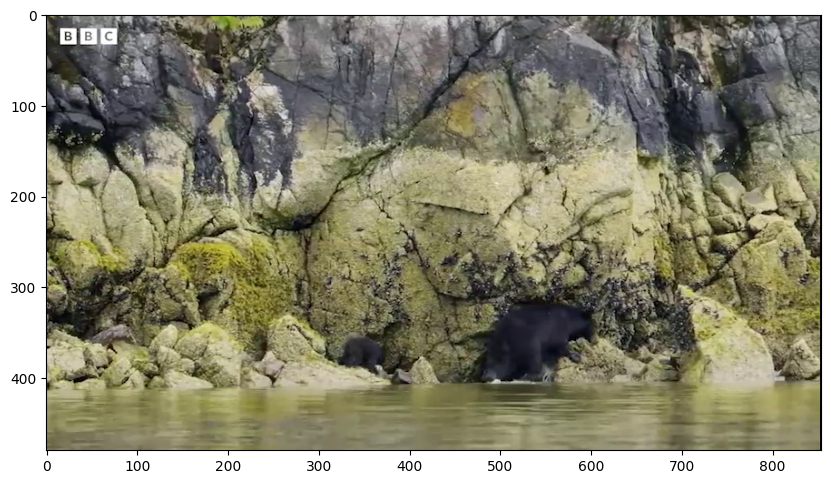

In [56]:
video_cap.set(cv2.CAP_PROP_POS_MSEC, 5750)  # 5750 milliseconds = 5.75 seconds
ret, frame = video_cap.read()
plt.figure(figsize = (10, 8))
plt.imshow(frame[...,::-1])

In [11]:
# Part 1: Video I/O Application

# Define the paths for input and output videos
# We'll read from Main.mp4 and create a grayscale version as output
input_video_path = '/content/Visual/bears1.mp4'
output_video_path = '/content/Visual/bears1_Grayscale.mp4'

# Initialize video capture object to read from the input video file
# cv2.VideoCapture() creates a video capture object that can read frames from a video
cap = cv2.VideoCapture(input_video_path)

# Extract important video properties that we'll need for the output video
# CAP_PROP_FRAME_WIDTH/HEIGHT: Get the dimensions of each video frame
# CAP_PROP_FPS: Get the frames per second of the input video
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
frame_rate = int(cap.get(cv2.CAP_PROP_FPS))

# Set up the video writer object to save the processed frames
# fourcc: Four character code that specifies the video codec (mp4v for MP4 format)
# isColor=False because we're writing grayscale frames
fourcc = cv2.VideoWriter_fourcc(*'XVID')
frame_fps = int(frame_rate/3)
out = cv2.VideoWriter(output_video_path, fourcc, frame_rate, (frame_width, frame_height), isColor=False)

# Main processing loop: read frames, convert to grayscale, and write to output
while cap.isOpened():
    # Read a single frame from the video
    # ret: Boolean indicating if frame was successfully read
    # frame: The actual image data of the frame
    ret, frame = cap.read()
    if not ret:
        # Break the loop if we've reached the end of the video
        break

    # Convert the frame from BGR color space to grayscale
    # OpenCV reads images in BGR (Blue-Green-Red) format by default
    # cv2.COLOR_BGR2GRAY converts from BGR color space to single-channel grayscale
    gray_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    # Write the processed grayscale frame to the output video
    out.write(gray_frame)

# Clean up: release video capture and writer objects
# This properly closes the files and frees up system resources
cap.release()
out.release()
# # Close any OpenCV windows that might have been opened
# # cv2.destroyAllWindows()

In [12]:
clip = VideoFileClip(output_video_path)
clip.ipython_display(width = 600)

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


In [50]:
import cv2
from google.colab.patches import cv2_imshow
from IPython.display import clear_output
import time

For example, here we download and display a PNG image of the Colab logo:

In [51]:

# Path to your video file
video_path = '/content/Visual/bears1.mp4'

# Create a VideoCapture object
cap = cv2.VideoCapture(video_path)

# Check if the video file was successfully opened
if not cap.isOpened():
    print("Error opening video file")

# Get the video's frame rate
fps = cap.get(cv2.CAP_PROP_FPS)

# Loop through the video frames
try:
  while cap.isOpened():
      # Read a frame from the video
      ret, frame = cap.read()

      # If frame is read correctly, ret is True
      if not ret:
          print("Can't receive frame (stream end?). Exiting ...")
          break

      # Display the frame using cv2_imshow
      cv2_imshow(frame)  # Display the frame

      # Calculate the delay needed for the desired frame rate
      delay = 1.0 / fps

      # Clear the previous frame's output to simulate continuous playback
      clear_output(wait=True)

      # Wait for the calculated delay
      time.sleep(delay)

except KeyboardInterrupt:
  # Handle KeyboardInterrupt to gracefully stop the playback
  print("Playback stopped by user.")

# Release the VideoCapture object and close any OpenCV windows
cap.release()
cv2.destroyAllWindows()

Can't receive frame (stream end?). Exiting ...




---



## Part 2: Motion Detection Application with Foreground Mass and Erosion

**Requirements:**

- **Input:** Use a video clip (less than one minute long) that shows some movement.
- **Processing:**
    - Create a **background model** from the initial frames.
    - Compute the **foreground mass** by taking the difference between the current frame and the background model.
    - Apply **erosion** to the foreground mask to remove noise (explain how erosion removes small, isolated noise pixels).
- **Output:** Annotate the frames (e.g., draw bounding boxes around detected motion areas) and write the output to a new video file.

**Instructions:**

1. **Background Modeling & Foreground Mass:**
2. **Applying Erosion:**
3. **Annotation and Video Output:**
    - Draw bounding rectangles (or other markers) around the regions of motion detected in the eroded foreground mask.
    - Write the annotated frames to a new output video.
    
Bonus: You can include intermediate visualizations (e.g., display the raw foreground mask vs. the eroded mask) to show the effect of erosion.



---



## Part 3: Contour Detection Application

**Requirements:**

 - **Input:** Use an image that contains distinct shapes (or create one with simple geometric shapes).
 - **Processing:**
    - Convert the image to grayscale and threshold it to create a binary image.
    - Use cv2.findContours to detect the contours.
    - Use cv2.drawContours to overlay the detected contours on the original image.
- **Output:** Display the resulting image with contours drawn.
- **Bonus:** Extend your code to process a video stream frame-by-frame, drawing contours on each frame.

**Instructions:**

1. **Image Preprocessing:**
    - Load the image and convert it to grayscale.
    - Apply a binary threshold to segment the shapes.
2. **Contour Detection:**
    - Use cv2.findContours with appropriate retrieval and approximation modes.
    - Explain the output: a list of contours and (optionally) a hierarchy that indicates relationships between contours.
3. **Drawing the Contours:**
    - Use cv2.drawContours to overlay the detected contours onto the image.
    - Display the final image.
4. **(Bonus) Video Contour Detection:**
    - Modify your code from Part 1 to process a video.
    - For each frame, detect contours and draw them before writing the frame to an output video file.

Hint: Choose a short video clip (under one minute) to ensure quick processing and review.



---



---



1. IPython.display.Video:

 * Pros:
     - Simple: Easy to use, just provide the video file path.
     - Native: Integrates well with the notebook environment.
     - Basic Controls: Offers basic playback controls (play, pause, volume).
 * Cons:
     - Limited Functionality: Lacks advanced controls (seeking, frame-by-frame stepping).
     - No Processing: Not suitable for displaying processed video frames directly (you'd need to save the output to a file first).

2. MoviePy:

 * Pros:
     - Flexibility: Provides greater control over playback and manipulation (seeking, trimming, effects).
     - Direct Display: Can display processed video frames directly using clip.ipython_display().
     - More Features: Offers a wider range of video editing and processing capabilities.
 * Cons:
     - More Complex: Requires understanding MoviePy's API and functions.
     - Potential Overhead: Might have some performance overhead compared to IPython.display.Video.

3. Outputting to a File:

 * Pros:
     - Versatility: Works with any video processing library or method.
     - Standard Approach: A common way to share and display processed videos.
     - Compatibility: The output video file can be played in various environments.
 * Cons:
     - Extra Step: Requires saving the processed video to a file before displaying.
     - Storage: Consumes storage space for the output video file.

**The Best Option:**

**For most cases, especially if you're doing video processing, Outputting to a File is generally the best option.**

Here's why:

 - Flexibility: It allows you to use any video processing technique you want with OpenCV or other libraries.
 - Clarity: Separates the processing and display stages, making your code more organized.
 - Sharing: The output video file can be easily shared and viewed outside of the notebook.

When to use the other options:

 - IPython.display.Video: If you just need to quickly display an existing video file without any processing.
 - MoviePy: When you need more control over playback or want to apply basic video editing or effects directly within the notebook.

**In specific scenarios, where you're using OpenCV for video processing, the recommended approach is to:**

1. Process your video using OpenCV.
2. Save the processed frames to a new video file using `cv2.VideoWriter`.
3. Embed or link the output video file in your Colab notebook using `IPython.display.Video` or by providing a download link.

This workflow gives you the most flexibility, clarity, and compatibility for your video processing projects in Colab.